
# The pole balancing problem
Course: Simulation Intelligence and Autonomous Systems<br>
Institution: Università degli studio di Trieste<br>
Author: Arahí Fernández Monagas<br>
Date: October 2025


In [ ]:
import numpy as np
import sympy as sp
import matplotlib.pyplot as plt

In [ ]:
sp.init_printing(use_unicode=True)

# Variables and states
x1 = sp.symbols('theta')      # pole angle with the vertical
x2 = sp.symbols('theta_dot')  # pole angular velocity
x3 = sp.symbols('pc')          # cart position
x4 = sp.symbols('pc_dot')      # cart velocity


x = sp.Matrix([x1, x2, x3, x4])  # state vector
u = sp.symbols('F')               # control input (force applied to the cart)

g = sp.symbols('g')    # gravity acceleration
m_c = sp.symbols('m_c')  # cart mass
m_p = sp.symbols('m_p')  # pole mass
l = sp.symbols('l')    # half pole length
mu_p = sp.symbols('mu_p')  # pole friction coefficient

print("State vector (x):\n")
sp.pprint(x)
print("\nInput (u):", u)

State vector (x):

⎡  θ   ⎤
⎢      ⎥
⎢θ_dot ⎥
⎢      ⎥
⎢  pc  ⎥
⎢      ⎥
⎣pc_dot⎦

Input (u): F


In [ ]:
#Definition of the system
x1_dot = x2
numer_f2 = g * sp.sin(x1) + sp.cos(x1) * ((-u - m_p * l * x2**2 * sp.sin(x1)) / (m_c + m_p)) - (mu_p * x2) / (m_p * l)
denom_f2 = l * (sp.Rational(4, 3) - (m_p * sp.cos(x1)**2) / (m_c + m_p))
x2_dot = numer_f2 / denom_f2
x3_dot = x4
x4_dot = (u + m_p * l * (x2**2 * sp.sin(x1) - x2 * sp.cos(x1))) / (m_c + m_p)

x_dot = sp.Matrix([x1_dot, x2_dot, x3_dot, x4_dot])
print("\nState derivatives (x_dot):")
sp.pprint(x_dot)



State derivatives (x_dot):
⎡                        θ_dot                         ⎤
⎢                                                      ⎥
⎢           ⎛               2       ⎞                  ⎥
⎢           ⎝-F - l⋅mₚ⋅θ_dot ⋅sin(θ)⎠⋅cos(θ)   μₚ⋅θ_dot⎥
⎢g⋅sin(θ) + ──────────────────────────────── - ────────⎥
⎢                       m_c + mₚ                 l⋅mₚ  ⎥
⎢──────────────────────────────────────────────────────⎥
⎢                   ⎛        2       ⎞                 ⎥
⎢                   ⎜  mₚ⋅cos (θ)   4⎟                 ⎥
⎢                 l⋅⎜- ────────── + ─⎟                 ⎥
⎢                   ⎝   m_c + mₚ    3⎠                 ⎥
⎢                                                      ⎥
⎢                        pc_dot                        ⎥
⎢                                                      ⎥
⎢                ⎛     2                      ⎞        ⎥
⎢       F + l⋅mₚ⋅⎝θ_dot ⋅sin(θ) - θ_dot⋅cos(θ)⎠        ⎥
⎢       ───────────────────────────────────────        ⎥
⎣  

In [ ]:
#Now I'll calculate the equilibrium point
x_eq = x_dot.subs([
    (u, 0),
    (x2, 0),
    (x4, 0)
])
sp.pprint(x_eq)

# Solve for equilibrium points
equilibrium_points = sp.solve([eq for eq in x_eq], (x1, x2, x3, x4))
print("\nEquilibrium points:")
sp.pprint(equilibrium_points)

eq_1 = sp.Matrix([0,0,0,0])
eq_2 = sp.Matrix([sp.pi,0,0,0])
u_bar = 0

⎡         0          ⎤
⎢                    ⎥
⎢      g⋅sin(θ)      ⎥
⎢────────────────────⎥
⎢  ⎛        2       ⎞⎥
⎢  ⎜  mₚ⋅cos (θ)   4⎟⎥
⎢l⋅⎜- ────────── + ─⎟⎥
⎢  ⎝   m_c + mₚ    3⎠⎥
⎢                    ⎥
⎢         0          ⎥
⎢                    ⎥
⎣         0          ⎦

Equilibrium points:
[(0, θ_dot, pc, pc_dot), (π, θ_dot, pc, pc_dot)]


In [ ]:
#Linearization around the equilibrium point
A = x_dot.jacobian(x)
B = x_dot.jacobian(sp.Matrix([u]))

g_val = 9.81  # m/s^2
m_c_val = 1.0  # kg
m_p_val = 0.1  # kg
l_val = 0.5    # m
mu_p_val = 0.05  # N/m/s

#Checking stability for the first equilibrium point (downward position)

A_eq1 = A.subs([
    (x1, eq_1[0]),
    (x2, eq_1[1]),
    (x3, eq_1[2]),
    (x4, eq_1[3]),
    (u, u_bar)
])

A_eq1 = A_eq1.subs([
    (g, g_val),
    (m_c, m_c_val),
    (m_p, m_p_val),
    (l, l_val),
    (mu_p, mu_p_val)
])

eigenvals_eq1 = A_eq1.eigenvals()
print("\nEigenvalues at Equilibrium Point 1 (Downward Position):")
for val, mult in eigenvals_eq1.items():
    sp.pprint(val)
    if sp.re(val) > 0:
        print("Unstable eigenvalue detected.")
        print("Unstable equilibrium at downward position.\n")
        break
    else:
        continue

#Checking stability for the second equilibrium point (upward position)
A_eq2 = A.subs([
    (x1, eq_2[0]),
    (x2, eq_2[1]),
    (x3, eq_2[2]),
    (x4, eq_2[3]),
    (u, u_bar)
])

A_eq2 = A_eq2.subs([
    (g, g_val),
    (m_c, m_c_val),
    (m_p, m_p_val),
    (l, l_val),
    (mu_p, mu_p_val)
])
eigenvals_eq2 = A_eq2.eigenvals()
print("\nEigenvalues at Equilibrium Point 2 (Upward Position):")
for val, mult in eigenvals_eq2.items():
    sp.pprint(val)
    # Check for positive eigenvalues having imaginary parts
    if sp.re(val) > 0:
        print("Unstable eigenvalue detected.")
        print("Unstable equilibrium at upward position.\n")
        break
    else:
        continue

print("Stable equilibrium at upward position.\n")


Eigenvalues at Equilibrium Point 1 (Downward Position):
0
-4.85944781516531
3.24969171760433
Unstable eigenvalue detected.
Unstable equilibrium at downward position.


Eigenvalues at Equilibrium Point 2 (Upward Position):
0
-0.804878048780488 - 3.89151366998299⋅ⅈ
-0.804878048780488 + 3.89151366998299⋅ⅈ
Stable equilibrium at upward position.



In [ ]:
display(A_eq2)

⎡        0                  1           0  0⎤
⎢                                           ⎥
⎢-15.7917073170732  -1.60975609756098   0  0⎥
⎢                                           ⎥
⎢        0                  0           0  1⎥
⎢                                           ⎥
⎣        0          0.0454545454545455  0  0⎦

3. Given the sequence of control inputs  [u(0),u(1),⋯,u(100)]=[]  simulate the behavior of the non linear and linear systems

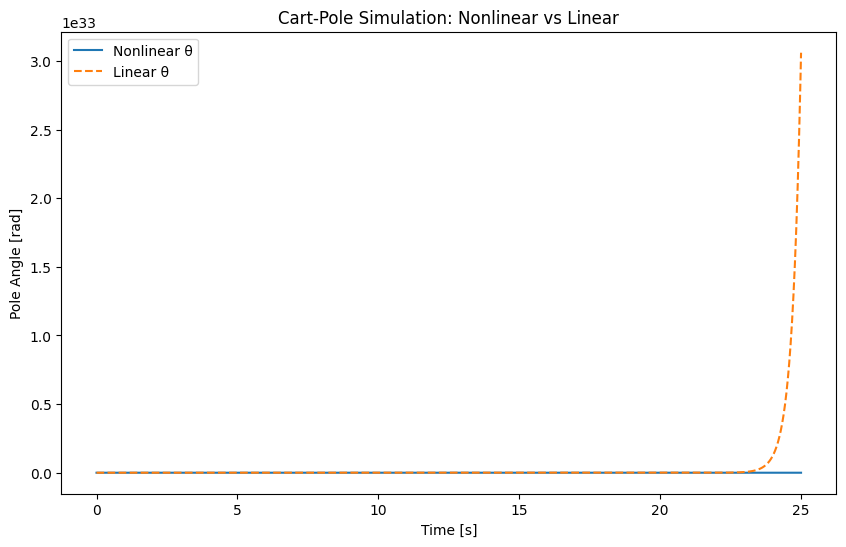

In [ ]:
import scipy.linalg

dt = 0.01
N = 2500
T = N*dt
t_vec = np.linspace(0, T, N)

# input sequence (es. impulso iniziale)
u_seq = np.zeros(N)
u_seq[0] = 10.0


# Substitute numerical values for parameters
params = {
    g: 9.81,
    m_c: 1.0,
    m_p: 0.1,
    l: 0.5,
    mu_p: 0.05
}

# Convert symbolic expressions to numerical functions
f_sym = x_dot
f_num = sp.lambdify((x1, x2, x3, x4, u), f_sym.subs(params), 'numpy')

# Linearized system matrices at downward equilibrium
A_num = np.array(A.subs({**params, x1: 0, x2: 0, x3: 0, x4: 0, u: 0})).astype(float)
B_num = np.array(B.subs({**params, x1: 0, x2: 0, x3: 0, x4: 0, u: 0})).astype(float)

def simulate_nonlinear(x0, u_seq, dt):
    X = np.zeros((len(u_seq)+1, 4))
    X[0] = x0
    for k, uk in enumerate(u_seq):
        dx = np.array(f_num(*X[k], uk)).flatten()
        X[k+1] = X[k] + dx * dt
    return X

def simulate_linear(x0, u_seq, dt):
    X = np.zeros((len(u_seq)+1, 4))
    X[0] = x0
    for k, uk in enumerate(u_seq):
        dx = A_num @ X[k] + B_num.flatten() * uk
        X[k+1] = X[k] + dx * dt
    return X
u_seq = np.zeros(N)
x0 = np.array([0.1, 0, 0, 0])

X_nl = simulate_nonlinear(x0, u_seq, dt)
X_lin = simulate_linear(x0, u_seq, dt)

plt.figure(figsize=(10,6))
plt.plot(t_vec, X_nl[:-1,0], label='Nonlinear θ')
plt.plot(t_vec, X_lin[:-1,0], '--', label='Linear θ')
plt.xlabel('Time [s]')
plt.ylabel('Pole Angle [rad]')
plt.legend()
plt.title('Cart-Pole Simulation: Nonlinear vs Linear')
plt.show()


Non-linear simulation complete.


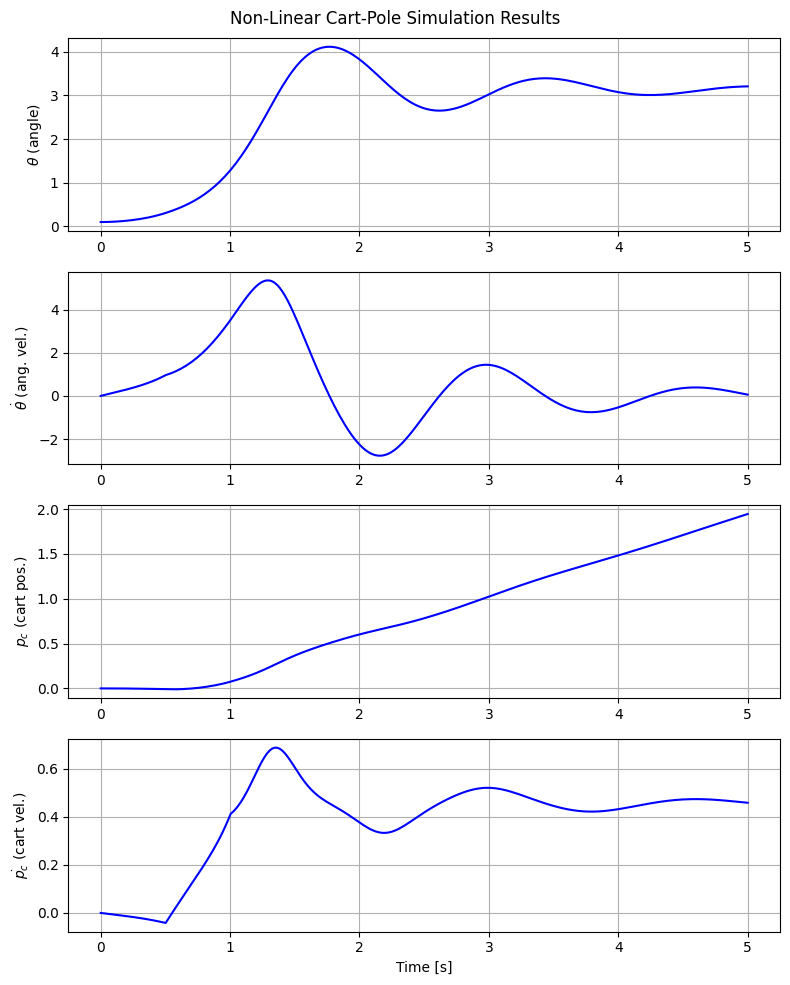

In [ ]:
import numpy as np
import scipy.linalg
from scipy.integrate import odeint
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import warnings

g = 9.81     # m/s^2
m_c = 1.0    # kg (cart mass)
m_p = 0.1    # kg (pole mass)
l = 0.5      # m (half-pole length from PDF) [cite: 4302]
L_pole = l * 2 # Full pole length for animation
mu_p = 0.05  # N/m/s (pole friction)


def cartpole_dynamics(x, t, u):
    theta, theta_dot, pc, pc_dot = x
    F = u


    num_f2 = ( g*np.sin(theta)
             + np.cos(theta)*((-F - m_p*l*theta_dot**2*np.sin(theta))/(m_c+m_p))
             - (mu_p*theta_dot)/(m_p*l) )
    den_f2 = l*(4./3. - (m_p*np.cos(theta)**2)/(m_c+m_p))
    th_ddot = num_f2 / den_f2

    num_f4 = ( F + m_p*l*(theta_dot**2*np.sin(theta) - th_ddot*np.cos(theta)) )
    den_f4 = m_c + m_p
    pc_ddot = num_f4 / den_f4

    return np.array([theta_dot, th_ddot, pc_dot, pc_ddot])

dt = 0.02  # Time step
T = 5.0    # Total time
N = int(T / dt) # Number of steps
t_array = np.linspace(0, T, N)

# Control input sequence (a small pulse)
u_seq = np.zeros(N)
u_seq[int(0.5 / dt) : int(1.0 / dt)] = 1.0 # 1N force from 0.5s to 1.0s

# Initial state (slightly tilted upward pendulum)
x0 = np.array([0.1, 0, 0, 0])
x_nl = np.zeros((N, 4))
x_nl[0,:] = x0

for k in range(N-1):
    t_span = [t_array[k], t_array[k+1]]
    # Integrate from x_nl[k] to get x_nl[k+1]
    sol = odeint(
        lambda x, t: cartpole_dynamics(x, t, u_seq[k]),
        x_nl[k,:],
        t_span
    )
    x_nl[k+1,:] = sol[-1,:]

print("Non-linear simulation complete.")

labels = [r'$\theta$ (angle)', r'$\dot{\theta}$ (ang. vel.)', r'$p_c$ (cart pos.)', r'$\dot{p_c}$ (cart vel.)']
fig_plot, axs = plt.subplots(4,1, figsize=(8,10))
fig_plot.suptitle('Non-Linear Cart-Pole Simulation Results')
for i in range(4):
    axs[i].plot(t_array, x_nl[:,i], 'b')
    axs[i].set_ylabel(labels[i])
    axs[i].grid(True)
axs[-1].set_xlabel('Time [s]')
plt.tight_layout()
plt.show()
warnings.filterwarnings("ignore", category=UserWarning, message="Matplotlib is currently using agg")
plt.rcParams['animation.embed_limit'] = 50.0

fig_anim, ax_anim = plt.subplots(figsize=(8, 6))
ax_anim.set_xlim(-2.0, 2.0)
ax_anim.set_ylim(-1.0, 2.0)
ax_anim.set_aspect('equal')
ax_anim.grid(True)
ax_anim.set_title('Cart-Pole Simulation (Non-Linear)')
ax_anim.set_xlabel('Cart Position (m)')

# Define elements
cart_w, cart_h = 0.3, 0.2
pole_line, = ax_anim.plot([], [], 'r-', lw=3, label='Pole')
cart_rect = plt.Rectangle(
    (-cart_w/2, -cart_h/2), cart_w, cart_h,
    fill=True, color='tab:gray', label='Cart'
)
ax_anim.add_patch(cart_rect)
ground_line = ax_anim.plot([-2.5, 2.5], [-cart_h/2, -cart_h/2], 'k-', lw=2)
ax_anim.legend(loc='upper right')

def animate(i):
    theta_i = x_nl[i, 0]
    pc_i = x_nl[i, 2]

    # Calculate coordinates
    pole_base_x = pc_i
    pole_base_y = cart_h / 2

    # Correct trigonometry: x = L*sin(theta), y = L*cos(theta)
    pole_tip_x = pole_base_x + L_pole * np.sin(theta_i)
    pole_tip_y = pole_base_y + L_pole * np.cos(theta_i)

    # Update plot elements
    cart_rect.set_xy((pc_i - cart_w/2, -cart_h/2))
    pole_line.set_data([pole_base_x, pole_tip_x], [pole_base_y, pole_tip_y])

    return pole_line, cart_rect

# Create and display animation
ani = animation.FuncAnimation(
    fig_anim,
    animate,
    frames=N,
    interval=dt*1000,
    blit=True
)

plt.close(fig_anim)
HTML(ani.to_jshtml())

Linear (Euler) simulation complete.


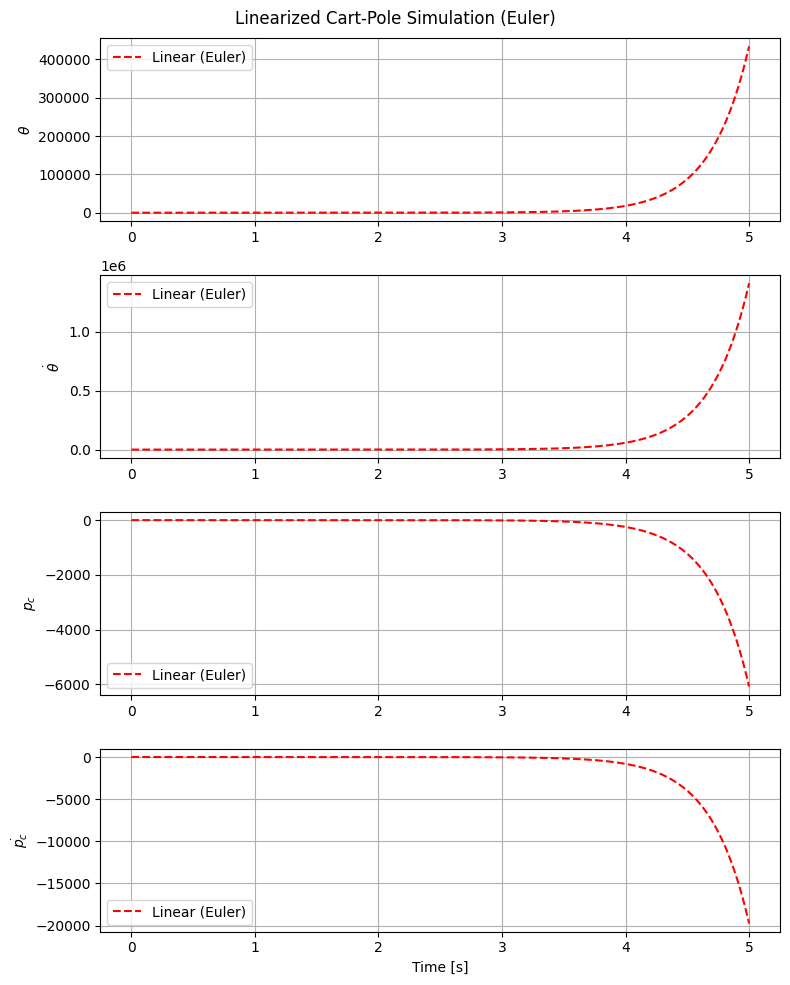

In [ ]:
dt = 0.01  # Time step
T = 5.0    # Total time
N = int(T / dt) # Number of steps
# t_array needs N points for plotting against N steps of simulation
t_array = np.linspace(0, T, N)

u_seq = np.zeros(N)
u_seq[int(0.5 / dt) : int(1.0 / dt)] = 1.0

x_bar = np.array([0.0, 0.0, 0.0, 0.0])
u_bar = 0.0
x0 = np.array([0.1, 0, 0, 0])
delta_x0 = x0 - x_bar

# --- 4. Run LINEAR Simulation (Euler Method) ---
# We simulate the *deviation* (delta_x)
delta_x_lin = np.zeros((N, 4))
delta_x_lin[0, :] = delta_x0

for k in range(N-1):
    delta_u_k = u_seq[k] - u_bar

    # \dot{\delta x} = A \delta x + B \delta u
    delta_x_dot_k = A_num @ delta_x_lin[k, :] + B_num.flatten() * delta_u_k

    # Euler integration: \delta x_{k+1} = \delta x_k + dt * \dot{\delta x}_k
    delta_x_lin[k+1, :] = delta_x_lin[k, :] + dt * delta_x_dot_k

# Get the absolute state for plotting/animation
# x = \delta x + \bar{x}
x_lin = delta_x_lin + x_bar
print("Linear (Euler) simulation complete.")

# --- 5. Plot Results ---
labels = [r'$\theta$', r'$\dot{\theta}$', r'$p_c$', r'$\dot{p_c}$']
fig, axs = plt.subplots(4, 1, figsize=(8, 10))
fig.suptitle('Linearized Cart-Pole Simulation (Euler)')
for i in range(4):
    # Plot t_array (N points) vs x_lin (N points)
    axs[i].plot(t_array, x_lin[:, i], 'r--', label="Linear (Euler)")
    axs[i].set_ylabel(labels[i])
    axs[i].legend()
    axs[i].grid(True)
axs[-1].set_xlabel('Time [s]')
plt.tight_layout()
plt.show()

# --- 6. Animation ---
warnings.filterwarnings("ignore", category=UserWarning, message="Matplotlib is currently using agg")
plt.rcParams['animation.embed_limit'] = 50.0

fig_anim, ax_anim = plt.subplots(figsize=(8, 6))
ax_anim.set_xlim(-2.0, 2.0)
ax_anim.set_ylim(-1.0, 2.0)
ax_anim.set_aspect('equal')
ax_anim.grid(True)
ax_anim.set_title('Cart-Pole Simulation (Linearized)')
ax_anim.set_xlabel('Cart Position (m)')

cart_w, cart_h = 0.3, 0.2
pole_line, = ax_anim.plot([], [], 'r--', lw=3, label='Pole (Linear)')
cart = plt.Rectangle((-cart_w/2, -cart_h/2), cart_w, cart_h, fill=True, color='tab:gray')
ax_anim.add_patch(cart)
ax_anim.plot([-2.0, 2.0], [-cart_h/2, -cart_h/2], 'k-', lw=2) # Ground
ax_anim.legend(loc='upper right')


def animate_lin(i):
    # Get state from the linear simulation
    theta_i = x_lin[i, 0]
    pc_i = x_lin[i, 2]

    # Calculate coordinates (Correct physics for theta=0 being UP)
    pole_base_x = pc_i
    pole_base_y = cart_h / 2
    pole_tip_x = pole_base_x + L_pole * np.sin(theta_i)
    pole_tip_y = pole_base_y + L_pole * np.cos(theta_i)

    # Update plot elements
    cart.set_xy((pc_i - cart_w/2, -cart_h/2))
    pole_line.set_data([pole_base_x, pole_tip_x], [pole_base_y, pole_tip_y])
    return pole_line, cart

ani = animation.FuncAnimation(
    fig_anim,
    animate_lin,  # Use the correct function name
    frames=N,
    interval=dt*1000,
    blit=True
)

plt.close(fig_anim)
HTML(ani.to_jshtml())